# MolSim 2020: ML for Gas Adsorption

In this exercise we will build a model that can predict the CO$_2$ uptake of MOFs, which are framework materials in which inorganic metal nodes are linked by organic linkers on some net topology. 

![MOF building principle](_static/mof_building_principle.png)

There are two main **learning goals** for this exercise: 
1. Understand the typical workflow for machine learning in materials science. We will cover exploratory data analysis (EDA) and supervised learning (KRR).
2. Learn about some Python packages that are useful for data analysis and visualization. If you are not already familiar with Python, this exercise can be a great opportunity to learn some basics.

This means that at the end of the exercise, you will produce a graph like the following, i.e. an interactive plot that plots the predictions for CO$_2$ uptake, made by your model, against the values generated with GCMC simulations. 
The histograms show the distributions of the errors and one of the subplots shows the training error, wheras the other shows the test error.

![Parity interactive](_static/result.gif)

For some of the exercises we assume some basic knowledge of Python, e.g. that you can write list comprehensions,  understand the documentation of packages or the docstrings of the functions. 
You will usually need to provide some function arguments (we indicate the places with 'fillme' comments like `#fillme`)

If you struggle with this, click on the provided hints and/or partner up with someone more experienced. There are also several optional exercises for those how already have a good knowledge of Python and machine learning.

You can execute all the following code cells by pressing SHIFT and ENTER, you can find more tips in the notes. 

## -1. Only if you run on Colab

If you use this notebook on Colab, you have to do some additional preparatory steps. For this uncomment the cell below (remove the `#`) and execute the cell.

In [ ]:
#!pip install --upgrade pandas pandas-profiling sklearn holoviews bokeh plotly matplotlib
#!wget https://raw.githubusercontent.com/kjappelbaum/ml_molsim2020/master/descriptornames.py

## 0. Import packages we will need

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
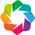

In [1]:
# basics 
import os 
import numpy as np 
import pprint as pp

# data
import pandas as pd 
import pandas_profiling

# machine learning 
# scaling of data
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
# train/test split
from sklearn.model_selection import train_test_split
# model selection 
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
# model
from sklearn.kernel_ridge import KernelRidge
# pipeline 
from sklearn.pipeline import Pipeline
# PCA
from sklearn.decomposition import PCA
# Dummy model
from sklearn.dummy import DummyClassifier, DummyRegressor
# Variance Threshold 
from sklearn.feature_selection import VarianceThreshold, SelectFromModel
# metrics 
from sklearn.metrics import (accuracy_score, precision_score, recall_score, f1_score,
                             mean_absolute_error, mean_squared_error, max_error)
# feature names
from descriptornames import * 

# save/load models 
import joblib

# For the permutation importance implementation
from joblib import Parallel
from joblib import delayed
from sklearn.metrics import check_scoring
from sklearn.utils import Bunch
from sklearn.utils import check_random_state
from sklearn.utils import check_array

# plotting 
import matplotlib.pyplot as plt 
%matplotlib inline 
import seaborn as sns

# for interactive plots, you can try to use holoviewes
import holoviews as hv
from holoviews import dim, opts
hv.extension('plotly', 'bokeh', 'matplotlib')

RANDOM_SEED = 4242424242
DATA_DIR = 'data'
DATA_FILE = os.path.join(DATA_DIR, 'data.csv')

np.random.seed(RANDOM_SEED)

def view_structure(name):
    import webbrowser
    webbrowser.open(f'https://discover.materialscloud.org/mofs/detail?name={name}', new=2)

 $\color{DarkBlue}{\textsf{Short question}}$
- We declared a global variable to fix the random seed (`RANDOM_SEED`). Why did we do this?  

## 1. Import the data

In [2]:
df = pd.read_csv(DATA_FILE)

Let's take a look at the first few rows to see if everythings seems reasonable ...

In [3]:
df.head()

,ASA [m^2/cm^3],CellV [A^3],Df,Di,Dif,NASA [m^2/cm^3],POAV [cm^3/g],POAVF,PONAV [cm^3/g],PONAVF,...,pure_methane_widomHOA,pure_uptake_CO2_298.00_15000,pure_uptake_CO2_298.00_1600000,pure_uptake_methane_298.00_580000,pure_uptake_methane_298.00_6500000,logKH_CO2,logKH_CH4,CH4DC,CH4HPSTP,CH4LPSTP
0,2329.01,1251.28,6.61256,8.87694,8.48668,0.0,0.818919,0.68874,0.0,0.0,...,-8.144317,0.111981,14.218595,1.680640,9.163066,-5.125451,-5.511444,175.569974,215.005044,39.435070
1,1983.81,1254.01,5.80566,7.13426,7.13154,0.0,0.495493,0.58032,0.0,0.0,...,-10.208005,0.481625,9.312424,1.513152,5.908356,-4.502967,-5.505947,143.616349,193.059644,49.443295
2,2259.13,1250.58,5.99131,8.01682,7.98933,0.0,0.728036,0.65710,0.0,0.0,...,-8.479801,0.401683,14.796071,1.569714,7.933198,-4.433968,-5.525707,160.238808,199.765744,39.526937
3,1424.54,1249.27,4.73477,7.05822,7.05822,0.0,0.453157,0.47338,0.0,0.0,...,-12.615382,0.821747,10.816880,2.161833,6.710778,-4.135434,-5.297082,132.576623,195.582107,63.005483
4,2228.31,1250.61,6.40783,8.35944,8.26946,0.0,0.700539,0.65092,0.0,0.0,...,-8.743404,0.258905,14.153999,1.653013,8.272621,-4.774301,-5.515219,171.601539,214.452966,42.851427


<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li>Use something like <code>pd.options.display.max_columns=10</code> to adjust how many columns are shown.</li>
</ul>
</details>

In [ ]:
df.to_csv(DATA_FILE, index=False)

Let's also get some basic information ...

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Columns: 343 entries, ASA [m^2/cm^3] to CH4LPSTP
dtypes: float64(342), object(1)
memory usage: 45.5+ MB


In [13]:
df['sum-D_func-I-0-all'].dtype

dtype('float64')

In [15]:
[c for c in list(df.columns) if df[c].dtype == object]

['MOFname']

 $\color{DarkBlue}{\textsf{Short question}}$
- How many materials are in the dataset? 
- Which datatypes do we deal with?

$\color{DarkRed}{\textsf{Solution}}$
 
- Materials:  17379, 
- float and object
  

Below, we define three global variables (hence upper case), which are the names of our feature and target columns. 

In [16]:
TARGET = 'pure_uptake_CO2_298.00_1600000' 
TARGET_BINARY = 'target_binned'
FEATURES = (geometric_descriptors + summed_functionalgroup_descriptors 
            + summed_linker_descriptors + summed_metalcenter_descriptors)

As descriptors we will use geometric properties such as density, pore volume, ... and [revised autocorrelation functions](https://pubs.acs.org/doi/abs/10.1021/acs.jpca.7b08750) that are autocorrelations that were optimized for describing inorganic compounds. 

They do so by encoding metal center, linkers and the functional groups as differences or products of heuristics, that are relevant for inorganic chemistry (here electronegativity ($\chi$), connectivity ($T$), identity ($I$), covalent radii ($S$), and nuclear charge ($Z$)), on the structure graph.

![RACs scheme from the lecture](_static/racs.png)

The RACs descriptors are in the lists `summed_functionalgroup_descriptors`, 
`summed_linker_descriptors` and `summed_metalcenter_descriptors`. The number shows the coordination shell that was considered in the calculation of the RACs.

For the pore geometry descriptors, $D_i$ is the largest included sphere size, $D_f$ the largest free sphere, and $D_{if}$ the largest included free sphere along the path---all different flavors of pore sizes. 
![pore diameters](_static/spheres.png)

More details on the description of pore geometries are provided by [Ongari et al.](https://pubs.acs.org/doi/abs/10.1021/acs.langmuir.7b01682)

SA describes the surface area and POV the pore occupiable volume.

## 2. Split the data

Before doing any analysis or transformation on the data, we split it into two disjoint sets. 
If you want more explanation why this is important, you might want to look into [chapter 7.10.2 of Elements of Statistical Learning](https://web.stanford.edu/~hastie/ElemStatLearn//printings/ESLII_print10.pdf). In a nutshell, we want to avoid *any* data leakage (i.e., that any information from the test set enters into the modeling)---also in terms of the feature selection.

### 2.1. Split with stratification

If there are imbalanced classes, we want to make sure that random sampling does not distort class distributions. 
I.e., if we would have only very few good materials in our dataset, we might have nearly none of them in our test set if we are unlucky in our random sampling. 

[Stratification](https://en.wikipedia.org/wiki/Stratified_sampling) ensures that the class distributions (ratio of good to bad materials) are the same in the training and test set.

For stratification to work, we need categories. Currently, our target is continuos, i.e. we have to binarize it. 
As a threshold we will use---following [Boyd et al.](https://www.nature.com/articles/s41586-019-1798-7)---2 mmol CO$_2$ / g for the target property. 

 $\color{DarkBlue}{\textsf{Short Exercise}}$
 - create a column that encodes using 0 (low performing) and 1 (high perfoming) the category which a material belongs to.

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> you can use <a href='https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.cut.html'>pd.cut</a>, 
    <a href='https://stackoverflow.com/questions/4406389/if-else-in-a-list-comprehension'>list comprehension</a>, the <a href='https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.Binarizer.html#sklearn.preprocessing.Binarizer'> binarizer in sklearn </a>...) </li>
    <li> an example using list comprehension is <code> [1 if value > THRESHOLD else 0 for value in df[TARGET]] </code> </li>
</ul>
</details>

In [17]:
THRESHOLD = 2 # mmol CO2/g
df['target_binned'] = [1 if value > THRESHOLD else 0 for value in df[TARGET]]

Now, we can perform the actual split into training and test set.

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- select reasonable values for XX and XY and then perform the test/train splits. What do you consider when making this decision? 

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li>The size can either be integers or---easier---decimals like 0.1</li>
    <li>When you perform the split into training and test set you need to trade-off bias (pessimistic bias due to little training data) and variance (due to little test data) </li>
    <li>A typical split cloud be 70/30 </li>
</ul>
</details>

In [18]:
df_train_stratified, df_test_stratified = train_test_split(df, train_size=0.7, 
                                                                test_size=0.3, 
                                                                random_state=RANDOM_SEED, 
                                                                stratify=df['target_binned']) 

## 3. Exploratory data analysis (EDA) 

Now, as we are sure that we have put data aside that we won't touch, we can give it a closer look.

 $\color{DarkRed}{\textsf{Tip}}$
 
 The "MOFname" column uses the same identifier that is also used on the [MaterialCloud page](https://www.materialscloud.org/discover/mofs#mcloudHeader) for this dataset. There you can also click on the datapoints to visualize the structures. You can also use the `view_structure` function, e.g. `view_structure('str_m2_o10_o29_pcu_sym.69')`, to visualize any structure directly from the notebook.

In [20]:
view_structure('str_m2_o10_o29_pcu_sym.69')

### 3.1. Get some description of the data

Use the [`pandas_profiling`](https://github.com/pandas-profiling/pandas-profiling) package to get an overview over the data.

$\color{DarkBlue}{\textsf{Short Exercise}}$
- Are there skewed distributions? 
- Are there missing values? 
- What are other issues with the dataset that you might want to fix before training a model?
- How could one fix those issues?

Note that the function calculates many statistics by default, which can take some time. For this reason, we use the `minimal=True` option, which disables the calculation of correlations and dynamic binning.

*You can speed it up even more by subsampling the data.



$\color{DarkRed}{\textsf{Solution}}$
 
The computation can take some time, students should be patient. 

See profile report and warnings therein.

- Distributions are skewed, can be fixed by transforming the data (e.g., log Box-Cox, Yeo-Johnson ...)
- Features with constant values are not useful 
- There should be no missing values. If there were some, one could either drop them or use some imputation techniques.



<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> use <code>df.sample(500)</code> to get a random sample of 500 rows, e.g. `df_train_stratified.sample(500)`. </li>
    <li> the function call might then look like `pandas_profiling.ProfileReport(df_train_stratified.sample(500))` </li>
</ul>
</details>

You can use `profile.to_file(output_file="your_report.html")` to save the report to an HTML file, which can be needed if you run this exercise on Google Colab. 



In [21]:
profile = pandas_profiling.ProfileReport(df_train_stratified.sample(500), minimal=True)

In [22]:
profile.to_notebook_iframe()

### 3.2. Correlations

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Plot some features against the target property and calculate the Pearson and Spearman correlation coefficient (what is the different between those?) 
- What are the strongest correlations? 
- *Optional:* Are they different for the different targets (e.g., look at CH$_4$ uptake instead of CO$_2$ uptake) and does this correspond to what you would expect?

To get the correlation matrices, you can use the `df.corr(method=)`method on your dataframe (`df`).

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> To get the correlation with a target, you can use indexing. E.g. <code>df.corr(method='spearman')[TARGET]</code></li>
</ul>
</details>

$\color{DarkRed}{\textsf{Solution}}$
 
- You can use subsampling to speed up stuff.
- Also scipy has correlation functions 
- Be careful to not consider the correlation with other simulation results 

In [37]:
spearman_corr = df[FEATURES + [TARGET]].sample(1000).corr(method='spearman')[TARGET]

In [38]:
pearson_corr = df[FEATURES + [TARGET]].sample(1000).corr(method='pearson')[TARGET]

In [39]:
spearman_corr.sort_values(ascending=True)

density [g/cm^3]       -0.955919
sum-D_mc_CRY-T-2-all   -0.457836
sum-D_mc_CRY-T-1-all   -0.311722
sum-mc_CRY-T-1-all     -0.306256
sum-mc_CRY-T-0-all     -0.296479
                          ...   
sum-D_mc_CRY-I-1-all         NaN
sum-D_mc_CRY-I-2-all         NaN
sum-D_mc_CRY-I-3-all         NaN
sum-D_mc_CRY-T-0-all         NaN
sum-D_mc_CRY-S-0-all         NaN
Name: pure_uptake_CO2_298.00_1600000, Length: 165, dtype: float64

In [42]:
spearman_corr.sort_values(ascending=False)

pure_uptake_CO2_298.00_1600000    1.000000
total_POV_gravimetric             0.963277
total_SA_gravimetric              0.959124
total_POV_volumetric              0.949488
total_SA_volumetric               0.880873
                                    ...   
sum-D_mc_CRY-I-1-all                   NaN
sum-D_mc_CRY-I-2-all                   NaN
sum-D_mc_CRY-I-3-all                   NaN
sum-D_mc_CRY-T-0-all                   NaN
sum-D_mc_CRY-S-0-all                   NaN
Name: pure_uptake_CO2_298.00_1600000, Length: 165, dtype: float64

In [40]:
pearson_corr.sort_values(ascending=True)

density [g/cm^3]       -0.884578
sum-D_mc_CRY-T-2-all   -0.369078
sum-D_mc_CRY-T-1-all   -0.346914
sum-D_mc_CRY-T-3-all   -0.271568
sum-mc_CRY-T-1-all     -0.259550
                          ...   
sum-D_mc_CRY-I-1-all         NaN
sum-D_mc_CRY-I-2-all         NaN
sum-D_mc_CRY-I-3-all         NaN
sum-D_mc_CRY-T-0-all         NaN
sum-D_mc_CRY-S-0-all         NaN
Name: pure_uptake_CO2_298.00_1600000, Length: 165, dtype: float64

In [41]:
pearson_corr.sort_values(ascending=False)

pure_uptake_CO2_298.00_1600000    1.000000
total_SA_gravimetric              0.920706
total_POV_volumetric              0.911236
total_SA_volumetric               0.840087
total_POV_gravimetric             0.775542
                                    ...   
sum-D_mc_CRY-I-1-all                   NaN
sum-D_mc_CRY-I-2-all                   NaN
sum-D_mc_CRY-I-3-all                   NaN
sum-D_mc_CRY-T-0-all                   NaN
sum-D_mc_CRY-S-0-all                   NaN
Name: pure_uptake_CO2_298.00_1600000, Length: 165, dtype: float64

In [48]:
scatter1 = hv.Scatter(df_train_stratified, 'total_SA_gravimetric', 
                      [TARGET, 'total_POV_volumetric']).opts(color='total_POV_volumetric')

scatter2 = hv.Scatter(df_train_stratified, 'density [g/cm^3]', 
                      [TARGET, 'total_POV_volumetric']).opts(color='total_POV_volumetric')

scatter3 = hv.Scatter(df_train_stratified, 'sum-D_mc_CRY-T-2-all', 
                      [TARGET, 'total_POV_volumetric']).opts(color='total_POV_volumetric')

scatter1 + scatter2 + scatter3

:Layout
   .Scatter.I   :Scatter   [total_SA_gravimetric]   (pure_uptake_CO2_298.00_1600000,total_POV_volumetric)
   .Scatter.II  :Scatter   [density [g/cm^3]]   (pure_uptake_CO2_298.00_1600000,total_POV_volumetric)
   .Scatter.III :Scatter   [sum-D_mc_CRY-T-2-all]   (pure_uptake_CO2_298.00_1600000,total_POV_volumetric)

## 4. Baselines

For machine learning, it is important to get some *baselines* to which one then compare the results of a model. 

In practice, one can use really simple models, the state of the art, or simple heuristics to do this. We will use latter method here.

For this we use `Dummy` objects that only calculate the mean, the median or the most frequent case on the training set (when you run the `fit()` method on them) and then uses this to perform the predictions. 
This is, the prediction of a `DummyRegressor` with `mean` strategy will always be the mean. 

The advantage of using these sklearn objects, instead of only the mean, that they have the same methods as other predictors in sklearn, for which reason you can simply swap them in pipelines, where one chains many data transformation steps (see section 6).

### 4.1. Build dummy models

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Create [`DummyRegressor`](https://scikit-learn.org/stable/modules/generated/sklearn.dummy.DummyRegressor.html) instances for  `mean`, `median`. (e.g. `dummyinstance = DummyRegressor(strategy='')`)
- Train them on the training data (`dummyinstance.fit(df_train[FEATURES], df_train[TARGET_BINARY]`)

<details>
<summary> <font color='green'>Click here for hints</font></summary>
<ul>
    <li> to create <code>DummyRegressor</code> you can for example use <code> dummyregressor_mean = DummyRegressor(strategy='mean') </code> </li>
    <li> to fit it, you can use the  <code> dummyregressor_mean.fit(X, y) </code> method </li>
</ul>
</details>

In [49]:
# Build DummyRegressors
dummyregressor_mean = DummyRegressor(strategy='mean')
dummyregressor_median = DummyRegressor(strategy='median')

In [50]:
# Fit Dummy Regressors
dummyregressor_mean.fit(df_train_stratified[FEATURES], df_train_stratified[TARGET])
dummyregressor_median.fit(df_train_stratified[FEATURES], df_train_stratified[TARGET])

DummyRegressor(constant=None, quantile=None, strategy='median')

#### Evaluate the performance of the dummy models

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Calculate maximum error, mean absolute error and mean square error for the dummy regressors on training and test set. What would you expect those numbers to be? Do the actual values surprise you and what does this mean in practice when one reports metrics?

It can be handy to store the metrics in a nested dictionary: 

```python
{'dummyestimator1': {
                        'metric_a_key': metric_a_value, 
                        'metric_b_key': metric_b_value
                    },
 'dummyestimator2': {
                        'metric_a_key': metric_a_value, 
                        'metric_b_key': metric_b_value
                    },
 }
``` 

Addionally, it can also be handy to write functions that return all the metrics and that you can for example call with `get_regression_metrics(model, X, y_true)` and that then returns a dictionary with the metrics as key-value pairs. 

Below we give two functions that do that, you only need to fill some arguments to make it work.

In them, we calculate 

$\mathrm {MAE} =\frac{\sum _{i=1}^{n}\left|Y_{i}-\hat{y}_{i}\right|}{n}.$

and 

$\mathrm {MSE} = {\frac {1}{n}}\sum _{i=1}^{n}(Y_{i}-{\hat {Y_{i}}})^{2}.$ 

as well as the maximum error.

<details>
<summary> <font color='green'>Click here for hints</font></summary>
<ul>
    <li> to perform a prediction using a estimator object, you can call <code> classifier.predict(X) </code> </li>
    <li> to calculate metrics, you can for example call <code>accuracy_score(true_values, predicted_values) </code> </li>
</ul>
</details>

In [51]:
def get_regression_metrics(model, X, y_true): 
    """
    Get a dicionary with regression metrics:
    model: sklearn model with predict method
    X: feature matrix
    y_true: ground truth labels
    """
    y_predicted = model.predict(X)
    
    mae = mean_absolute_error(y_true, y_predicted)
    mse = mean_squared_error(y_true, y_predicted)
    maximum_error = max_error(y_true, y_predicted)
    
    metrics_dict = {
        'mae': mae, 
        'mse': mse, 
        'max_error': maximum_error
    }
    
    return metrics_dict

In [52]:
dummy_regressors = [
    ('mean', dummyregressor_mean), 
    ('median', dummyregressor_median)
]

In [56]:
dummy_regressor_results_test = {} # initialize empty dictionary
dummy_regressor_results_train = {}
for regressorname, regressor in dummy_regressors: 
    dummy_regressor_results_test[regressorname] = get_regression_metrics(
        regressor, df_test_stratified[FEATURES], df_test_stratified[TARGET])
    dummy_regressor_results_train[regressorname] = get_regression_metrics(
        regressor, df_train_stratified[FEATURES], df_train_stratified[TARGET])

In [57]:
dummy_regressor_results_test

{'mean': {'mae': 6.361670452835055,
  'mse': 54.520440551756394,
  'max_error': 22.581593582963503},
 'median': {'mae': 6.2989389150971995,
  'mse': 56.59302668818955,
  'max_error': 23.9890391609}}

In [58]:
dummy_regressor_results_train

{'mean': {'mae': 6.289619412082073,
  'mse': 53.72333739904923,
  'max_error': 22.715942610363502},
 'median': {'mae': 6.210715516760551,
  'mse': 55.70424045390224,
  'max_error': 24.123388188299998}}

$\color{DarkRed}{\textsf{Solution}}$
 
- There shouldn't be a big train-test difference. (we cannot overfit with such a simple approach)

## 5. Build actual regression models

Let's build a simple model and train it with our raw data. You can try different kernels, but we recommend to start with Gaussian kernels ('rbf') 
 
 $\color{DarkBlue}{\textsf{Short Question}}$
- Do you expect this model to perform better than the dummy models?
- Train it and then calculate the performance metrics on the train and test set and compare it to the scores you got for the dummy models.

In [60]:
# Train the model
krr = KernelRidge(kernel='rbf')
krr.fit(df_train_stratifiedain_stratified[FEATURES], df_train_stratified[TARGET])

KernelRidge(alpha=1, coef0=1, degree=3, gamma=None, kernel='rbf',
            kernel_params=None)

In [ ]:
# get the metrics on the train and the test set
krr_results_test = get_regression_metrics(
        krr, df_test_stratified[FEATURES], df_test_stratified[TARGET])
krr_results_train = get_regression_metrics(
        krr, df_train_stratified[FEATURES], df_train_stratified[TARGET])

In [ ]:
krr_results_test

In [ ]:
krr_results_train

Of course, one shouldn't use default model parameters and one usually should perform some feature engineering.
We will do this in the following to improve the predictive performance of our model.

## 6. Evaluate the model performance in detail

Now, lets investigate the performance of the model in more detail---beyond simple numeric scores.

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- for the training and test data, plot a parity plot (true values against predictions)
- plot a histogram of the distribution of the training and test errors on the training and test set, plot the errors also as a function of the true value
- for a setting in which we would the ML for prescreening purposes (i.e. to screen a library of millions of porous materials and to find those with the highest gas uptake) what kind of errors would you tolerate? Could you tolerate the errors of your model?
- compare the parity plots for this model with the ones for the dummy models. 
Use the plotting functions below the evaluate all the following models you train.

For this exercise, it can be handy to save the results in a dictionary, e.g. 
```(python)
res_train = {
    'y true': ,
    'y pred': 
}
```

As you will need to run this multiple times, it can be useful to make a function that can create such a dictionary.

<details>
<summary> <font color='green'>Click here for hints for plotting</font></summary>
<ul>
    <li> If you want to use matplotlib, you can use the <a href="https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.hist2d.html">hist2d function</a> </li>
    <li>to create the frequencies and the edges of a histogram, one can use <code>np.histogram</code></li>
</ul>
</details>

In [ ]:
# Create dictionaries with training and test results 
res_train = {
    'y true': df_train_stratified[TARGET],
    'y pred': krr.predict(df_train_stratified[FEATURES])
}

res_test = {
    'y true': df_test_stratified[TARGET],
    'y pred': krr.predict(df_test_stratified[FEATURES])
}

In [ ]:
res_train['error'] = res_train['y true'] - res_train['y pred']
res_test['error'] = res_test['y true'] - res_test['y pred']

# plot it
hv.extension('bokeh')
hex_train = hv.HexTiles(res_train, ['y true', 'y pred']).hist(dimension=['y true','y pred'])
hex_test = hv.HexTiles(res_test, ['y true', 'y pred']).hist(dimension=['y true', 'y pred'])
hex_train + hex_test

$\color{DarkRed}{\textsf{Solution}}$
 
- The model at this stage is pretty bad. This is to show the students the importance of the following steps (hyperparameter optimization, scaling and feature selection)

## 7. Improve the model

Some issues you might noticed with the data are that 
- The data is not properly scaled (different features might be measured in different units ...)
- Some features do not contain much information, e.g., are constant and just "blow up" our dimensionality 
- Some feature distributions are skewed (which is more relevant for some models than for others ...)
- There are only few good materials (also the target distribution is skewed), so we might have problems predicting well for the best materials

### 7.1. Standard scaling and building a first pipeline 

Given that we will now start doing more than just training a model, we will build [Pipelines](https://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html), which are objects that can be used to collect a selection of transformations and estimators.

This makes it quite easy to apply the same set of operations on different datasets.

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Build a pipline that first performs standard scaling and then a KRR. Call it `pipe_w_scaling`. 

<details>
<summary> <font color='green'>Click here for hints</font></summary>
<ul>
    <li> the <code>fit</code>, <code>predict</code> methods also work for pipelines </li>
</ul>
</details>

In [ ]:
pipe_w_scaling = Pipeline(
   [
       ('scaling', StandardScaler()), 
       ('krr', #fillme)
   ]
)

### 7.2. Hyperparameter optimization

The most basic way for doing this is grid search. In which we define a grid of parameters for which we want to evaluate the model performance.

In [ ]:
res_train['error'] = res_train['y true'] - res_train['y pred']
res_test['error'] = res_test['y true'] - res_test['y pred']

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Think about which parameters you could optimize in the pipeline, remember that you can also switch off some steps by setting them to `None'. Also, the model has some parameters you might want to optimize.
For each parameter you need to define a resonable range of parameters.
- Run the hyperparameter optimization using 5-fold cross-validation (you can adjust the number of folds according to your computational resources/impatience. It turns out at k=10 is the [best tradeoff between variance and bias](https://arxiv.org/abs/1811.12808)). 
Tune the hyperparameters until you are statisfied (e.g., until you cannot improve the cross validated error any more)
- Why don't we use the test set for hyperparameter tuning? 
- Evaluate the model performance by calculating the performance metrics (MAE, MSE, max error) on the training and the test set.
- Instead of grid search, try to use random search on the same grid (`RandomizedSearchCV`) and fix the number of evaluations to a fraction of the number of evaluations of grid search. What do you observe and conclude?

 $\color{DarkRed}{\textsf{Tips}}$
- If you want to see what is happening, set the verbosity argument of the `GridSearchCV` object to a higher number.
 
- If you want to speed up the optimization, you can run it in parallel by setting the `n_jobs` argument to the number of workers. If you set it to -1 it will use all available cores.
 
- If the optimization is too slow, reduce the number of datapoints, the number of folds or the grid size. Note that it can also be a feasible strategy to first use a coarser grid and the a finer grid for finetuning.

- For grid search, you need to define a parameter grid, which is a dictionary of the following form: 
```(python)
param_grid = {
                    'pipelinestage__parameter': np.logspace(-4,1,10),
                    'pipelinestage': [None, TransformerA(), TransformerB()]
            }
```

The double underscore (dunder) notation works recursively and specifies the parameters for any pipeline stage. For example, `ovasvm__estimator__cls__C` would specifiy the `C` parameter of the estimator in the one-versus-rest classifier. 

You can see all of them when you use `pp.pprint(sorted(pipeline.get_params().keys()))`

<details>
<summary> <font color='green'>Click here for hints about pipelines and grid search</font></summary>
<ul>
    <li> You can use the <code>np.logspace</code> function to generate a grid for values that you want to vary on a logarithmic scale </li>
    <li> There are two hyperparameters for KRR: the regularization strength &alpha and the Gaussian width &gamma </li>
    <li> For the regularization strength, values between 1 and 1e-3 can be reasonable. For gamma you can use the median heuristic, gamma = 1 / median, or values between 1e-3 and 1e3</li>
</ul>
</details>

In [ ]:
# Define the parameter grid and the grid search object
param_grid = {
                    'scaling': [MinMaxScaler(), StandardScaler()],
                    'krr__alpha': #fillme,
                    'krr__#fillme': #fillme
            }

grid_krr = GridSearchCV(#your pipeline, param_grid=param_grid, 
                        cv=#number of folds, verbose=2, n_jobs=-1)

random_krr = RandomizedSearchCV(#your pipeline, param_distributions=param_grid, n_iter=,
                        cv=#number of folds, verbose=2, n_jobs=-1)

In [ ]:
# run the grid search by calling the fit method 
grid_krr.fit(#fillme)
random_krr.fit(#fillme)

In [ ]:
# get the performance metrics
get_regression_metrics(#fillme)

<details>
<summary> <font color='green'>Click here for some more information about hyperparameter optimization</font></summary>
Note that using grid search is not the best way to perform hyperparamter optimization. Even <a href="http://jmlr.csail.mit.edu/papers/volume13/bergstra12a/bergstra12a.pdf">random search was shown to be more efficient</a>. Really efficient though are Bayesian optimization approaches like <a href='https://papers.nips.cc/paper/4443-algorithms-for-hyper-parameter-optimization.pdf)'>TPE</a>. This is implemented in the hyperopt library, which we also installed in the conda enviornment for this course.
</details>

<details>
<summary> <font color='green'>Click here for hyperparameter optimization with hyperopt (advanded and optional outlook)</font></summary>
    
<b>Import the tools we need</b>
<code>
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, mix, rand, anneal, space_eval
from functools import partial
</code>    

<b>Define the grid</b>
<code>
param_hyperopt = {
    "krr__alpha": hp.loguniform("krr__alpha", np.log(0.001), np.log(10)),
    "krr__gamma": hp.loguniform("krr__gamma", np.log(0.001), np.log(10)),
}
</code> 

<b>Define the objective function</b>
<code>
def objective_function(params):
    pipe.set_params(
        **{
            "krr__alpha": params["krr__alpha"],
            "krr__gamma": params["krr__gamma"],
        }
    )
    score = cross_val_score(
        pipe, X_train, y_train, cv=10, scoring="neg_mean_absolute_error"
    ).mean()
    return {"loss": -score, "status": STATUS_OK} 
</code>

<b>We will use a search in which we mix random search, annealing and tpe</b>
<code>
trials = Trials()
mix_search = partial(
   mix.suggest,
   p_suggest=[(0.15, rand.suggest), (0.15, anneal.suggest), (0.7, tpe.suggest)],
)
</code>

<b>Now, we can minimize the objective function.</b>
<code>
best_param = fmin(
        objective_function,
        param_hyperopt,
        algo=mix_search,
        max_evals=MAX_EVALES,
        trials=trials,
        rstate=np.random.RandomState(RANDOM_SEED),
    )
</code>

</details>

## 8. Feature Engineering 

The next thing we want to optimize is to remove features with low variance, we can do this by using a variance threshold.

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Add a variance threshold to the pipeline (select the correct function argument)
- Use random search for hyperparameter optimization, retrain the pipeline, and calculate the performance metrics (max error, MAE, MSE) on the training and test set

In [ ]:
# Define the pipeline
pipe_variance_threshold = Pipeline(
    # fillme with the pipeline steps
    [
        ('variance_treshold', VarianceThreshold(#fillme))
    ]
)

In [ ]:
param_grid_variance_threshold = {
                    'scaling__parameter': [None, StandardScaler()],
                    'krr__alpha': #fillme,
                    'krr__#fillme': #fillme
            }

random_variance_treshold = RandomizedSearchCV(#your pipeline, param_distributions=param_grid, n_iter=,
                        cv=#number of folds, verbose=2, n_jobs=-1)

In [ ]:
# Fit the pipeline and run the evaluation
random_variance_treshold.fit(#fillme)

$\color{DarkBlue}{\textsf{Short Exercise (optional)}}$
- replace the variance threshold with a model-based feature selection 
`('feature_selection', SelectFromModel(LinearSVC(penalty="l1")))`

## 9. Saving the model

Now, that we spent so much time in optimizing our model, we do not want to loose it. 

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- use the [joblib library](https://scikit-learn.org/stable/modules/model_persistence.html) to save your model
- make sure you can load it again

Use this to save models as you go.

In [ ]:
# Dump your model
joblib.dump(model, filename)

In [ ]:
# Try to load it again
model_loaded = joblib.load(filename)

## 10. Submit your results to Kaggle (optional)

Join the [Kaggle competition](http://www.kaggle.com/c/molsim2020) for this course!

Create `submission.csv` with your predictions to join the competition and upload it to the competition site.

In [ ]:
kaggle_data = pd.read_csv('data/features.csv')
kaggle_predictions = #fillme.predict(kaggle_data[TARGET])

In [ ]:
submission = pd.DataFrame({
    "id": kaggle_data["id"],
    "prediction": kaggle_predictions
})

submission.to_csv("submission.csv", index=False)

## 11. Influence of Regularization (optional)

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- what happens if you set $\alpha=0$ or to large value? Why is this the case?

 To test this, fix this value in one of your pipelines (you might want to re-optimize the other hyperparameters), retrain the models and rerun the performance evaluation.

<details>
<summary> <font color='green'>Click here for hints</font></summary>
<ul>
    <li> Check the derivation for ridge regression and KRR in the notes. </li>
</ul>
</details>

## 12. Interpreting the model

Now, that our model performs decently, we would like to now what features are resposible for this, i.e. how the model performs it's reasoning. 

One method to do so is the [permutation feature importance technique](https://christophm.github.io/interpretable-ml-book/feature-importance.html).

$\color{DarkBlue}{\textsf{Short question}}$

We use both descriptors that encode the pore geometry (density, pore diameters, surface areas) as well as some that describe the chemistry of the MOF (the RACs). 
- Would you expect the relative importance of these features to be different for prediction of gas adsorption at high vs low gas pressure?

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> <a href="https://pubs.acs.org/doi/abs/10.1021/acs.chemmater.8b02257">An article from Diego et al.</a> (10.1021/acs.chemmater.8b02257) gives some hints.</li>
</ul>
</details>

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Complete the function `_calculate_permutation_scores` (which we took from the `sklearn` package) and which is needed to calculate the permutation feature importance using the `permutation_importance` function. 

In [ ]:
def _calculate_permutation_scores(estimator, X, y, col_idx, random_state,
                                  n_repeats, scorer):
    """Calculate score when `col_idx` is permuted. Based on the sklearn implementation
    
    estimator: sklearn estimator object
    X: pd.Dataframe or np.array
    y: pd.Dataframe or np.array
    col_idx: int
    random_state: int
    n_repeats: int 
    scorer: function that takes model, X and y_true as arguments
    """
    random_state = check_random_state(random_state)

    X_permuted = X.copy()
    scores = np.zeros(n_repeats)
    # get the indices
    shuffling_idx = np.arange(X.shape[0])
    for n_round in range(n_repeats):
        # shuffle them (fill in what you want to shuffle)
        random_state.shuffle(#fillme)  
        
        # Deal with dataframes
        if hasattr(X_permuted, "iloc"):
            # .iloc selects the indices from a dataframe and yougive it [row, column]
            col = X_permuted.iloc[#fillme]
            col.index = X_permuted.index
            X_permuted.iloc[:, col_idx] = col
            
        # Deal with numpy arrays 
        else:
            # array indexing is [row, column]
            X_permuted[:, col_idx] = X_permuted[#fillme]
        
        # Get the scores
        feature_score = scorer(estimator, X_permuted, y)
        
        # record the scores in array 
        scores[n_round] = feature_score

    return scores

In [ ]:
def permutation_importance(estimator, X, y, scoring=None, n_repeats=5,
                           n_jobs=-1, random_state=None):
    """Permutation importance for feature evaluation 
    estimator : object
        An estimator that has already been :term:`fitted` and is compatible
        with :term:`scorer`.
    X : ndarray or DataFrame, shape (n_samples, n_features)
        Data on which permutation importance will be computed.
    y : array-like or None, shape (n_samples, ) or (n_samples, n_classes)
        Targets for supervised or `None` for unsupervised.
    scoring : string, callable or None, default=None
        Scorer to use. It can be a single
        string (see :ref:`scoring_parameter`) or a callable (see
        :ref:`scoring`). If None, the estimator's default scorer is used.
    n_repeats : int, default=5
        Number of times to permute a feature.
    n_jobs : int or None, default=None
        The number of jobs to use for the computation.
        `None` means 1 unless in a :obj:`joblib.parallel_backend` context.
        `-1` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.
    random_state : int, RandomState instance, or None, default=None
        Pseudo-random number generator to control the permutations of each
        feature. See :term:`random_state`.
    """
    # Deal with dataframes
    if not hasattr(X, "iloc"):
        X = check_array(X, force_all_finite='allow-nan', dtype=None)

    # Precompute random seed from the random state to be used
    # to get a fresh independent RandomState instance for each
    # parallel call to _calculate_permutation_scores, irrespective of
    # the fact that variables are shared or not depending on the active
    # joblib backend (sequential, thread-based or process-based).
    random_state = check_random_state(random_state)
    random_seed = random_state.randint(np.iinfo(np.int32).max + 1)
     
    # Determine scorer from user options.
    scorer = check_scoring(estimator, scoring=scoring)
    # get the performance score on the unpermuted data 
    baseline_score = scorer(estimator, X, y)
    
    # run the permuted evaluations in parallel for each column
    scores = Parallel(n_jobs=n_jobs)(delayed(_calculate_permutation_scores)(
        estimator, X, y, col_idx, random_seed, n_repeats, scorer
    ) for col_idx in range(X.shape[1]))
    
    # get difference two
    importances = baseline_score - np.array(scores)
    
    # return the results (dictionary)
    return Bunch(importances_mean=np.mean(importances, axis=1),
                 importances_std=np.std(importances, axis=1),
                 importances=importances)

In [ ]:
permutation_results = permutation_importance(#fillme)

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Use your function to find the five most important features. Would you expect this result?

<details>
<summary> <font color='green'>Click here for hints</font></summary>
<ul>
    <li> To get the top <emph>n</emph> indices of an array <code>a</code>, you can use <code>np.argsort(a)[-n:]</code></li>
    <li> Get the feature names from the <code>FEATURES</code> list </li> 
</ul>
</details>

Note that also this method is not a silver bullet, e.g. there are issues with correlated features, but it is likely [a better choice than feature importance, like impurity decrease, derived from random forestes](https://explained.ai/rf-importance/).

## 13. PCA (optional) 

The output of `df_train.shape` will show you that our data is high-dimensional. 
It's hard to visualize such data.

$\color{DarkBlue}{\textsf{Short Exercise}}$
- How many features do we use?

One way to visualize high dimensional data is to use [principal component analysis (PCA)](https://en.wikipedia.org/wiki/Principal_component_analysis) which baiscally tries to find linear combinations of features that explain most of the variance in the data. But this method also has some caveats, which we will explore later in this exercise, and which non-linear techniques like [t-sne](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding) try to avoid. 

One can then plot the data in two dimensions in terms of the two first principal components.

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- plot the explained variance as a function of the number of principal components and plot a scree plot. Use all features for this analysis (on the training set). Would it be possible to compress this dataset using PCA? 
- plot the dataset in terms of the first two principal components. What are the features that are most important in those first principal components (look at the loadings of the first two principal components). 

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> A scree plot shows the explained variance as a function of the number of components. For this, we run <code>PCA(n_components=n_features)</code>, where <code>n_components=X.shape[1] </code> </li>
    <li> The <code> PCA </code> object also has a <code> fit </code> method </li>
</ul>
</details>

In [ ]:
# Build the PCA objects and run it 
pca = PCA(n_components=#fillme)
pca.fit(StandardScaler().fit_transform(df_train_stratified[#fillme]))

In [ ]:
# Plot the scree plot
data = {
            'feature' : np.arange(0, len(#fillme)),
            'explained variance ratio': pca.explained_variance_ratio_
        }

hv.Curve(data, 'feature', 'explained variance ratio')

#### PCA on Swiss Roll  

Some data comes in interesting shapes. 
The Swiss roll dataset was created to test out 
dimensionality reduction algorithms by creating some data in 2D and mapping it then to 3D  using a smooth function (here: $(x,y,z) := (x \cos (x), y, x \sin(x))$).

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- Create some Swiss roll data (using the `gaussian_mixture_data` to create Gaussian mixture data in 2D and then map it to 3D using `map_to_3d`). Visualize the data first in 2D and then, after the mapping, in 3D. 

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> Both <code>means</code> and <code>covariances</code> take lists as input.  </li>
    <li> The list for the means contains tuples of (x,y) coordinates for the centers of the Gaussian blobs and the list for the covariances takes floats. </li>
    <li> try e.g. <code> means = [(-2, -2), (-2,2), (2,-2), (2,2)], covariances = [1,1,1,1] </code> </li>
    <li> for plotting in matplotlib you can use the <a href="https://matplotlib.org/3.1.0/api/_as_gen/matplotlib.pyplot.scatter.html"><code>plt.scatter</code></a>. You can use the <code>c</code> argument to color the points.
</ul>
</details>

In [ ]:
def gaussian_mixture_data(means: list=[(-2, -2), (1,1)], 
                          covariances: list=[1], numpoints: int=200) -> pd.DataFrame:
    """
    generate some gaussian mixture data
    """
    from sklearn.datasets import make_gaussian_quantiles
    assert len(means) == len(covariances)
    
    X = []
    Y = []
    c = []
    
    # loop over all means and covariances
    for i, mucov in enumerate(zip(means, covariances)):
        mu, cov = mucov
        print(f'making blob of mean {mu} and covariance {cov}')
        x, y = make_gaussian_quantiles(mean=mu, cov=cov,
                                         n_samples=numpoints, 
                                         random_state=RANDOM_SEED)
        X.append(x[:,0])
        Y.append(x[:,1])
        c.append([i  + 1] * numpoints)
    
    gaussian_mix = {
        'x': np.array(X).flatten(),
        'y': np.array(Y).flatten(),
        'color': np.array(c).flatten() 
    }
    
    return pd.DataFrame.from_dict(gaussian_mix)

In [ ]:
gaussian_mix = gaussian_mixture_data(##fillme)

##### Plot it 

In [ ]:
# plot it
scatter = hv.Scatter(gaussian_mix, 'x', ['y', 'color']).opts(color='color', cmap='rainbow')
scatter

##### Map it to 3D and plot it

In [ ]:
def map_to_3d(x: float, y:float) -> list: 
    """
    x cos (x), y, x sin(x)
    Feel free to play aroung with it
    """
    return [.5 * x * np.cos(x), y,   2 * x * np.sin(x)]

$\color{DarkBlue}{\textsf{Short Exercise}}$
- Add the correct arguments (instead of `##fillme`) to the function call in the list comprehension.
- Plot the result in three dimensions using the 'color' column for coloring

In [ ]:
coordinates = np.array([map_to_3d(#fillme) for x,y in zip(gaussian_mix['x'], gaussian_mix['y'])])

gaussian_mix['x'] = coordinates[:,0]
gaussian_mix['y'] = coordinates[:,1]
gaussian_mix['z'] = coordinates[:,2]

In [ ]:
# Plot the data in 3d
scatter3d = hv.Scatter3D(#fillme, kdims=['x', 'y'], vdims=['z', 'color'])
scatter3d = scatter3d.opts(
            opts.Scatter3D(color='color',  cmap='rainbow'))
scatter3d

##### Run the PCA transformation

Now, we can run the transformation on the training data. 
This is, project the data from feature space onto the first two principal components and then plot the data in two dimension in these coordinates.

$\color{DarkBlue}{\textsf{Short Exercise}}$
- Project the three dimensional swiss roll data onto the first two principal components
- Plot the data in two dimensions, use the original coloring (which could e.g. represent different material classes)


<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> To perform the the transformation, you can use the <code>fit_transform()</code> method of the <code>PCA(n_components=2)</code> instance</li>
    <li> To plot the data you can use the <code>Scatter</code> method from holoviews.</li>
</ul>
</details>



In [ ]:
# run the PCa
pca = PCA(#fillme)
swissroll_transformed = pca.fit_transform(#fillme)

In [ ]:
# plot it
swissroll_transformed_dict = {}
swissroll_transformed_dict['x'] = swissroll_transformed[:,#fill with a integer]
swissroll_transformed_dict['y'] = swissroll_transformed[:,#fill with a integer]
swissroll_transformed_dict['color'] = gaussian_mix['color']
scatter = hv.Scatter(swissroll_transformed_dict, 'x', ['y', 'color']).opts(
        color='color', cmap='rainbow')
scatter

 $\color{DarkBlue}{\textsf{Short Exercise}}$
- If you look at the 2D-plot, what would you have expected a dimensionality reduction to do? What did actually happen? 
- What happens to the transformation if you scale one feature? What does it mean in practice when you e.g. want to understand the importance of features in terms of their variance?

<details>
<summary> <font color='green'>Click here for a hint</font></summary>
<ul>
    <li> To standardize one variable you can use <code>gaussian_mix['x'] = (gaussian_mix['x']- gaussian_mix['x'].mean())/gaussian_mix['x'].std()</code> </li>
    <li> Or just try to multiply by a constant </li>
    <li> For practical application, give a look to the data in the dataframe ... it might come in different units ... </li>
</ul>
</details>


## Additional research questions

- Change the target from CO$_2$ to methane. Is it easier to predict? What changes in the feature importance?
- Do also a search over model space, do you find better performance with a Gradient Boost model? 